Updated from: topic_modeling_with_lda_modular

Instead of applying a global threshold on the lda-transformed tf matrix, for each sample, pick the community that has largest signal for it. This will discretize the communities. 

In [1]:
from __future__ import print_function
from time import time

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

import sys, os

import biom
from biom import parse_table, load_table

from numpy import array
import numpy as np
from scipy.sparse import csr_matrix

import matplotlib.pyplot as plt
%matplotlib inline

import pandas as pd
import csv

from collections import defaultdict

from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D

import itertools # for flattening 2D lists

from mpl_toolkits.basemap import Basemap

In [2]:
def load_data(fname,num_sample):
    with open(fname) as f: 
        table = parse_table(f)
    
    # randomly subsample without replacement
    samp_table = table.subsample(num_sample,axis='sample',by_id=True)
    df = samp_table.to_dataframe()
       
    otus = [otu for otu in samp_table.ids(axis='observation')] # 'words'
    samples = [samp for samp in samp_table.ids()] # 'documents'
    
    n = len(samples)  # number of 'samples' or 'articles'
    m = len(otus)  # number of 'features' or 'words'
    
    otu_ids = array(list(xrange(m)))  # indices for 'words' in the dictionary
    samp_ids = array(list(xrange(n))) # indices for 'documents' in the corpus
    
    # construct at compressed sparse row format matrix, to represent the term-frequency (tf)
    # matrix
    tf = csr_matrix(df.values.reshape((n,m)))   
    
    # construct the dictionary, i.e. mapping from 'word IDs' to 'words'
    vocab = dict(zip(otu_ids, otus))
    
    return(tf,vocab,samples)

In [3]:
os.chdir('data/otu_tables_wTax')
fname = 'ITS_otu_table_wTax.biom'
num_sample = 500 # number of random subsamples
tf,vocab,samples = load_data(fname,num_sample)

In [4]:
print(tf.shape)

(500, 49177)


In [5]:
print(len(vocab))

49177


In [6]:
def print_top_words(model, feature_names, n_top_words):
    for topic_idx, topic in enumerate(model.components_):
        message = "Topic #%d: " % topic_idx
        message += " ".join([str(vocab[feature_names[i]])
                             for i in topic.argsort()[:-n_top_words - 1:-1]])
        #message += " ".join([str(feature_names[i])
        #                     for i in topic.argsort()[:-n_top_words - 1:-1]])
        print(message)
    print()
    
def find_words_per_topic(model,feature_names,n_top_words):
    topic_data = defaultdict(list)
    for topic_idx, topic in enumerate(model.components_):
        # list of sample IDs
        topic_data[topic_idx].append([str(vocab[feature_names[i]]) 
                                     for i in topic.argsort()[:-n_top_words -1:-1]]) 
    return(topic_data)    

def run_lda(n_topics,max_iter,tf,vocab):
    tf_vectorizer = CountVectorizer(max_df=1.0,min_df=0.0,vocabulary=list(set(vocab)))
    lda = LatentDirichletAllocation(n_components=n_topics, max_iter=max_iter,
                                learning_method='online',
                                learning_offset=50.,
                                random_state=0)
    lda.fit(tf)
    return(lda,tf_vectorizer)

In [7]:
n_topics = 10  #number of topics
max_iter = 50

lda,tf_vectorizer = run_lda(n_topics,max_iter,tf,vocab)

print("\nTopics in LDA model:")
tf_vectorizer._validate_vocabulary()
tf_feature_names = tf_vectorizer.get_feature_names()

n_top_words = 20
print_top_words(lda, tf_feature_names, n_top_words)


Topics in LDA model:
Topic #0: OTU_2262 OTU_22363 OTU_75231 OTU_4587 OTU_75480 OTU_18002 OTU_25252 OTU_46088 OTU_37630 OTU_43520 OTU_52896 OTU_61713 OTU_25449 OTU_28914 OTU_47191 OTU_31287 OTU_34546 OTU_75277 OTU_12782 OTU_15278
Topic #1: OTU_2525 OTU_41357 OTU_32744 OTU_3973 OTU_67975 OTU_65630 OTU_46661 OTU_4533 OTU_1230 OTU_36482 OTU_63043 OTU_58669 OTU_51763 OTU_74232 OTU_5386 OTU_69345 OTU_47277 OTU_42179 OTU_41099 OTU_55811
Topic #2: OTU_61643 OTU_3005 OTU_22431 OTU_18204 OTU_45807 OTU_4558 OTU_48211 OTU_69809 OTU_5462 OTU_47598 OTU_68302 OTU_63981 OTU_2516 OTU_67853 OTU_53506 OTU_13919 OTU_3417 OTU_8919 OTU_20631 OTU_52079
Topic #3: OTU_12765 OTU_37570 OTU_42227 OTU_54570 OTU_63454 OTU_21593 OTU_38037 OTU_8526 OTU_66679 OTU_6690 OTU_30918 OTU_2701 OTU_61297 OTU_57757 OTU_35386 OTU_60654 OTU_67605 OTU_64357 OTU_54122 OTU_8200
Topic #4: OTU_50313 OTU_57859 OTU_641 OTU_5304 OTU_67207 OTU_1385 OTU_37883 OTU_70046 OTU_56062 OTU_57368 OTU_640 OTU_5814 OTU_63817 OTU_5887 OTU_10967 OTU

In [8]:
topic_data = find_words_per_topic(lda,tf_feature_names,100)
print(topic_data[0])

[['OTU_2262', 'OTU_22363', 'OTU_75231', 'OTU_4587', 'OTU_75480', 'OTU_18002', 'OTU_25252', 'OTU_46088', 'OTU_37630', 'OTU_43520', 'OTU_52896', 'OTU_61713', 'OTU_25449', 'OTU_28914', 'OTU_47191', 'OTU_31287', 'OTU_34546', 'OTU_75277', 'OTU_12782', 'OTU_15278', 'OTU_64964', 'OTU_58367', 'OTU_14004', 'OTU_69106', 'OTU_7476', 'OTU_31913', 'OTU_36684', 'OTU_3185', 'OTU_51454', 'OTU_18135', 'OTU_5737', 'OTU_69433', 'OTU_19520', 'OTU_41456', 'OTU_59122', 'OTU_74764', 'OTU_66594', 'OTU_15620', 'OTU_5897', 'OTU_47403', 'OTU_61669', 'OTU_58204', 'OTU_57600', 'OTU_72270', 'OTU_12033', 'OTU_40486', 'OTU_1172', 'OTU_10710', 'OTU_25855', 'OTU_69446', 'OTU_57023', 'OTU_43569', 'OTU_13016', 'OTU_3250', 'OTU_67733', 'OTU_22449', 'OTU_60014', 'OTU_64100', 'OTU_17708', 'OTU_40205', 'OTU_9991', 'OTU_6727', 'OTU_64915', 'OTU_11263', 'OTU_62093', 'OTU_65601', 'OTU_62859', 'OTU_62959', 'OTU_55703', 'OTU_64080', 'OTU_16788', 'OTU_17090', 'OTU_810', 'OTU_6135', 'OTU_66019', 'OTU_63034', 'OTU_39823', 'OTU_35111

In [9]:
n_topics = 40  #number of topics
max_iter = 100

lda,tf_vectorizer = run_lda(n_topics,max_iter,tf,vocab)

print("\nTopics in LDA model:")
tf_vectorizer._validate_vocabulary()
tf_feature_names = tf_vectorizer.get_feature_names()

n_top_words = 20
print_top_words(lda, tf_feature_names, n_top_words)

topic_data = find_words_per_topic(lda,tf_feature_names,100)
print(topic_data[0])


Topics in LDA model:
Topic #0: OTU_75231 OTU_14004 OTU_47403 OTU_62959 OTU_45759 OTU_60305 OTU_35289 OTU_21629 OTU_9109 OTU_2053 OTU_20660 OTU_50436 OTU_548 OTU_19313 OTU_23226 OTU_57321 OTU_17533 OTU_19461 OTU_33829 OTU_37736
Topic #1: OTU_31554 OTU_9905 OTU_49387 OTU_37474 OTU_6302 OTU_8543 OTU_4133 OTU_74067 OTU_2257 OTU_31604 OTU_34021 OTU_7444 OTU_62381 OTU_31952 OTU_32756 OTU_71630 OTU_53469 OTU_64398 OTU_32714 OTU_33792
Topic #2: OTU_22431 OTU_45807 OTU_47598 OTU_63981 OTU_3417 OTU_52079 OTU_8919 OTU_20324 OTU_3679 OTU_31103 OTU_5013 OTU_25708 OTU_9805 OTU_26382 OTU_28485 OTU_47493 OTU_23493 OTU_59017 OTU_16694 OTU_6187
Topic #3: OTU_12765 OTU_37570 OTU_63454 OTU_21593 OTU_60654 OTU_52796 OTU_19834 OTU_4716 OTU_43046 OTU_26531 OTU_63776 OTU_53585 OTU_36125 OTU_73254 OTU_12551 OTU_13198 OTU_3904 OTU_31660 OTU_47598 OTU_56489
Topic #4: OTU_33908 OTU_51675 OTU_59232 OTU_62042 OTU_17098 OTU_30654 OTU_18919 OTU_9217 OTU_57583 OTU_64750 OTU_5460 OTU_30918 OTU_57719 OTU_52801 OTU_3863

[['OTU_75231', 'OTU_14004', 'OTU_47403', 'OTU_62959', 'OTU_45759', 'OTU_60305', 'OTU_35289', 'OTU_21629', 'OTU_9109', 'OTU_2053', 'OTU_20660', 'OTU_50436', 'OTU_548', 'OTU_19313', 'OTU_23226', 'OTU_57321', 'OTU_17533', 'OTU_19461', 'OTU_33829', 'OTU_37736', 'OTU_54594', 'OTU_36212', 'OTU_50419', 'OTU_38376', 'OTU_54754', 'OTU_32014', 'OTU_20469', 'OTU_70484', 'OTU_53624', 'OTU_18338', 'OTU_9898', 'OTU_49883', 'OTU_1013', 'OTU_8748', 'OTU_6855', 'OTU_20452', 'OTU_4734', 'OTU_41559', 'OTU_9947', 'OTU_37222', 'OTU_33836', 'OTU_42886', 'OTU_4580', 'OTU_6323', 'OTU_69085', 'OTU_54932', 'OTU_9778', 'OTU_54343', 'OTU_43968', 'OTU_294', 'OTU_1127', 'OTU_39505', 'OTU_1905', 'OTU_63440', 'OTU_59704', 'OTU_2207', 'OTU_74455', 'OTU_62171', 'OTU_65243', 'OTU_24073', 'OTU_4616', 'OTU_55072', 'OTU_64878', 'OTU_60511', 'OTU_5660', 'OTU_1346', 'OTU_33835', 'OTU_47362', 'OTU_7179', 'OTU_25399', 'OTU_33064', 'OTU_15318', 'OTU_39838', 'OTU_18850', 'OTU_11447', 'OTU_4417', 'OTU_55044', 'OTU_487', 'OTU_6547

In [10]:
# to find max_iter, fix n_topics, vary max_iter, and see at what point perplexity converges
def find_opt_iters(n_topics,tf):
    iters = [10,50,100,200]
    perp = []
    for it in iters:
        lda = LatentDirichletAllocation(n_components=n_topics, max_iter=it,
                                learning_method='online',
                                learning_offset=50.,
                                random_state=0)
        lda.fit(tf)
        perp.append(lda.perplexity(tf).tolist())
    return(iters,perp)

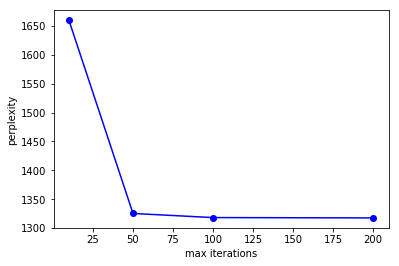

In [46]:
n_topics = 100
iters,perp = find_opt_iters(n_topics,tf)
plt.plot(iters,perp,'bo-')
plt.xlabel('max iterations')
plt.ylabel('perplexity')

In [49]:
# now vary the number of topics and plot perplexity, score as function of # topics
def find_opt_ntopics(tf):
    n_topics = [10,50,100,150,200]
    scores = []
    perp = []
    for n in n_topics:
        lda = LatentDirichletAllocation(n_components=n, max_iter=100,
                                learning_method='online',
                                learning_offset=50.,
                                random_state=0)
        lda.fit(tf)
        scores.append(lda.score(tf).tolist())
        perp.append(lda.perplexity(tf).tolist())
    return(n_topics,scores,perp)

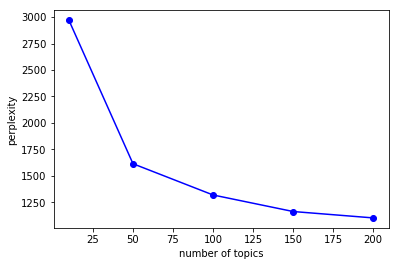

In [50]:
n_topics,scores,perp = find_opt_ntopics(tf)
plt.plot(n_topics,perp,'bo-')
plt.xlabel('number of topics')
plt.ylabel('perplexity')

In [51]:
# now select the optimum n_topics
n_topics = 200
max_iter = 100
lda,tf_vectorizer = run_lda(n_topics,max_iter,tf,vocab)
tf_fit = lda.fit_transform(tf) 

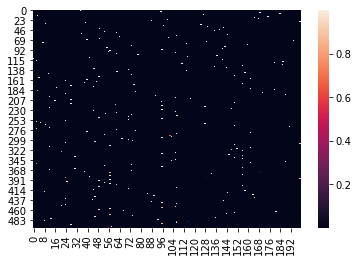

In [123]:
import seaborn as sns
sns.heatmap(tf_fit) # [n_samples x n_topics]

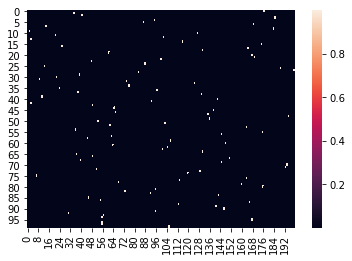

In [165]:
# for ease of visualization, look at a subset
sns.heatmap(tf_fit[0:99,:]) # [n_samples x n_topics]

In [124]:
# for each sample (row), find the community corresponding to the max signal in the tf_fit 
# matrix    
samp_com = np.argmax(tf_fit, axis=1)
print("The community for which a sample has the highest signal/presence:\n")
print(samp_com)
print("The unique communities present in these random subsamples:\n")
uniq_com = np.unique(samp_com)
print(uniq_com) 

The community for which a sample has the highest signal/presence:

[177  35  41 185  95  87 169  14 184   2 127  21 102   3 116 175  26 165
 131  61 168 170 100  48  88  13 189 199  83  39  22   9  74 125  76  24
  97  38 130  11 142  93   3  49  65 139  66 135 195 136  53 103  62 164
  36 176 145  63  45 107 148  64 105 101 131  37  49 151  40 145 194 193
  52 129 120   7 164 114  68 160 176  96  73  92 143  46  55 166 113 141
 147  96  31  57  56 168  56  56 106  20  62  46  78  18  84 137  43 115
 124  42  19 188   0  17 141   1   2 173 148 186  75 180 114 111  25 186
   2   6 156 199 135  96 144 144 130  45 103  71  13 114  96 156  62  45
 158  53  11 142  73  12 106 150  71  49  62   4 103 158 162  12  40 131
  24  12 162  47  84  38 142 156 103  75 162  49  28  46  45  45  17  24
 156 162 136 180 156   3 156  74  76  68 171  49  24  64 188 168  57  91
  53  12  67 106 150  96 117  24  28  74  16  45  96  12 107 150  61  28
   9  61 159  31  96 107 128 106  12  49 150 148  67  96 

In [125]:
print(len(samp_com))

500


In [126]:
# need to remove the '.O' or '.I' at the end of each sample ID 
samp_type = [None] * len(samples) # save sample type as 0 or 1 depending on if it was an outdoor or indoor sample
samples_new = [None] * len(samples)
for i in range(len(samples)):
    if '.O' in str(samples[i]):
        samp_type[i] = 0
        samples_new[i] = int(str(samples[i]).replace('.O',''))
    elif '.I' in str(samples[i]):
        samp_type[i] = 1  
        samples_new[i] = int(str(samples[i]).replace('.I',''))     
print(samples_new)

[931, 323, 737, 731, 337, 57, 963, 470, 1283, 721, 123, 706, 147, 412, 42, 277, 785, 821, 637, 899, 1215, 333, 70, 615, 554, 29, 638, 22, 750, 744, 278, 907, 182, 37, 1248, 385, 428, 432, 648, 490, 193, 597, 112, 794, 583, 173, 539, 260, 818, 719, 35, 525, 36, 1171, 528, 403, 418, 61, 348, 493, 401, 976, 691, 710, 14, 607, 799, 217, 853, 814, 349, 77, 288, 314, 1238, 640, 268, 704, 872, 836, 187, None, 34, 664, 115, 680, 1111, 787, 547, 1221, 49, 266, 832, 817, 1008, 134, 1162, 72, 990, 1159, 681, 620, 1060, 495, 650, 33, 367, 129, 1061, 1079, 555, 562, 756, 1109, 51, 692, 608, 317, 75, 1226, 1158, 805, 1000, 63, 170, 1295, 672, 957, 282, 1208, 462, 599, 364, 1074, 900, 569, 475, 527, 633, 767, 486, 584, 974, 26, 1105, 1081, 505, 610, 58, 481, 1019, 222, 1015, 789, 655, 937, 579, 227, 833, 59, 895, 41, 275, 1022, 880, 1214, 408, 820, 426, 982, 926, 1099, 305, 496, 344, 1071, 371, 484, 224, 1199, 924, 546, None, 1103, 935, 59, 208, 231, 761, 199, 1216, 412, 982, 50, 227, 636, 550, 685, 

In [127]:
# now for each community/topic, store a matrix of samples, locations + metadata assoc with 
# that sample
# create an empty pandas dataframe and populate it with this info

# index of the topics/communities; these will be the rows of the dataFrame
index = array(list(xrange(n_topics)))

columns = ['Samples','SampleType','Cities','States','Lat','Long','MeanAnnTemps','MeanAnnPrec','NetPrimProd','Elevation']

In [130]:
# load metadata
os.chdir('..')
fname = 'homes_mapping_file.txt'

with open(fname) as f:
    lines = f.readlines()
with open(fname,'r') as f:
    df = pd.read_csv(f,sep='\t')
df.head()

,ID,City,State,Latitude,Longitude,MeanAnnual Temperature,MeanAnnualPrecipitation,NetPrimaryProductivity,Elevation,Residence,NumberBedroooms
0,12,Hopkinton,NH,43.2,-71.7,6.960092,87.594419,2.144496,222.669723,A mobile home,3
1,13,Albuquerque,NM,35.1,-106.5,10.761468,26.163609,0.621555,1708.676392,One-family house detached from any other house,3
2,14,Savannah,GA,32.1,-81.1,19.113914,102.441208,2.431254,11.967500,One-family house detached from any other house,2
3,15,Renton,WA,47.4,-122.1,11.172859,85.494190,2.186705,144.733032,One-family house detached from any other house,4
4,16,Fort Plain,NY,42.9,-74.7,6.766437,88.573394,2.183677,429.188324,One-family house detached from any other house,3


In [162]:
# find all samples from Kansas
ks = df[df['State'] == 'KS'].index.tolist()
print(ks)

# find all communities from Kansas
#ks_com = samp_com[ks]
print(samp_com)

[96, 263, 379, 581, 838, 941, 1029, 1079, 1113, 1491]
[177  35  41 185  95  87 169  14 184   2 127  21 102   3 116 175  26 165
 131  61 168 170 100  48  88  13 189 199  83  39  22   9  74 125  76  24
  97  38 130  11 142  93   3  49  65 139  66 135 195 136  53 103  62 164
  36 176 145  63  45 107 148  64 105 101 131  37  49 151  40 145 194 193
  52 129 120   7 164 114  68 160 176  96  73  92 143  46  55 166 113 141
 147  96  31  57  56 168  56  56 106  20  62  46  78  18  84 137  43 115
 124  42  19 188   0  17 141   1   2 173 148 186  75 180 114 111  25 186
   2   6 156 199 135  96 144 144 130  45 103  71  13 114  96 156  62  45
 158  53  11 142  73  12 106 150  71  49  62   4 103 158 162  12  40 131
  24  12 162  47  84  38 142 156 103  75 162  49  28  46  45  45  17  24
 156 162 136 180 156   3 156  74  76  68 171  49  24  64 188 168  57  91
  53  12  67 106 150  96 117  24  28  74  16  45  96  12 107 150  61  28
   9  61 159  31  96 107 128 106  12  49 150 148  67  96   9  45  67 1

In [131]:
# all samples in the dataframe
all_samples = df['ID'].values
print(all_samples)

[  12   13   14 ..., 1642 1643 1644]


In [133]:
# construct pandas dataframe to store all samples and metadata associated with each topic
#import itertools

num_com = len(uniq_com)
# initialze empty lists of lists
samples_data = [[]]*num_com
samp_type_data = [[]]*num_com
city_data = [[]]*num_com
state_data = [[]]*num_com
lat_data = [[]]*num_com
long_data = [[]]*num_com
mat_data = [[]]*num_com
map_data = [[]]*num_com
npp_data = [[]]*num_com
elev_data = [[]]*num_com

for t in range(num_com): 
    # find indices for samples containing topic t in the random subsample
    s_idx = np.where(samp_com==uniq_com[t]) 
    s_idx = zip(*s_idx)
    s_idx = [i[0] for i in s_idx] # make into a list of sample indices
    
    samples_data[t] = [samples_new[i] for i in s_idx]
    samp_type_data[t] = [samp_type[i] for i in s_idx]
    
    # use indices for samples in the full dataset; flatten the 2D lists using itertools
    as_idx = [np.where(samples_new[i]==all_samples) for i in s_idx]
    city_data[t] = list(itertools.chain(*[df['City'].iloc[i].values.tolist() for i in as_idx])) 
    state_data[t] = list(itertools.chain(*[df['State'].iloc[i].values.tolist() for i in as_idx]))
    lat_data[t] = list(itertools.chain(*[df['Latitude'].iloc[i].values.tolist() for i in as_idx]))
    long_data[t] = list(itertools.chain(*[df['Longitude'].iloc[i].values.tolist() for i in as_idx]))
    mat_data[t] = list(itertools.chain(*[df['MeanAnnual Temperature'].iloc[i].values.tolist() for i in as_idx]))
    map_data[t] = list(itertools.chain(*[df['MeanAnnualPrecipitation'].iloc[i].values.tolist() for i in as_idx]))
    npp_data[t] = list(itertools.chain(*[df['NetPrimaryProductivity'].iloc[i].values.tolist() for i in as_idx]))
    elev_data[t] = list(itertools.chain(*[df['Elevation'].iloc[i].values.tolist() for i in as_idx]))

topic_data = [(samples_data[t],samp_type_data[t],city_data[t],state_data[t],
              lat_data[t],long_data[t],mat_data[t],map_data[t],npp_data[t],
              elev_data[t]) for t in range(num_com)]
print(type(topic_data))

<type 'list'>


In [134]:
columns = ['samples','sample_types','cities','states','latitude','longitude',
          'mean_ann_temp','mean_ann_precip','net_prim_prod','elevation']
dfnew = pd.DataFrame(data=topic_data,columns=columns)
dfnew.columns = columns
dfnew.head()

,samples,sample_types,cities,states,latitude,longitude,mean_ann_temp,mean_ann_precip,net_prim_prod,elevation
0,[756],[0],[North East],[PA],[42.1],[-79.9],[8.689296636],[87.49617737],[nan],[305.3861084]
1,[692],[0],[Albuquerque],[NM],[35.1],[-106.6],[10.76146789],[26.16360856],[0.621555117],[1708.676392]
2,"[721, 608, 672, 576, 1111, 970, 1578, 1220]","[0, 0, 0, 1, 1, 1, 1, 1]","[Golden, Kansas City, Star, Colorado Springs, ...","[CO, MO, ID, CO, IN, MS, CA, IA]","[39.7, 39.1, 43.7, 38.8, 41.6, 34.2, 37.4, 42.0]","[-105.2, -94.6, -116.5, -104.9, -85.8, -88.4, ...","[6.594877676, 12.5912844, 9.471559633, 9.46651...","[32.73715596, 79.44044343, 35.03555046, 29.632...","[0.677392489, 1.040240765, 1.093049672, 0.5202...","[2119.006104, 272.7763977, 1087.946655, 2004.2..."
3,"[412, 112, 59, 203]","[0, 0, 1, 1]","[Brooklyn, Brighton, macon, Raleigh]","[NY, MA, GA, NC]","[40.7, 42.3, 32.7, 35.8]","[-74.0, -71.2, -83.7, -78.7]","[11.81796636, 9.388990826, 18.10107034, 15.405...","[92.61200306, 94.63203364, 95.51941896, 94.054...","[2.213204125, 1.966573293, 2.086765599, 1.6989...","[23.8580265, 52.88596344, 130.1658325, 96.7572..."
4,[937],[0],[Hoboken],[NJ],[40.7],[-74.0],[11.15],[97.4837156],[2.213204125],[60.80302048]


In [149]:
dfnew.shape

(146, 10)

In [166]:
# overlay community distributions with all; normalize
def plot_hist_for_topic(topic,dfnew,df):
    f, axarr = plt.subplots(3, 2)
    axarr[0, 0].hist(df['Latitude'],color='g',alpha=0.25,label='all',normed=True)
    axarr[0, 0].hist(dfnew.loc[topic,'latitude'],color='b',alpha=0.25,label='community',normed=True)
    axarr[0, 0].set_xlabel('latitude')
    axarr[0, 1].hist(df['Longitude'],color='g',alpha=0.25,label='all',normed=True)
    axarr[0, 1].hist(dfnew.loc[topic,'longitude'],color='b',alpha=0.25,label='community',normed=True)
    axarr[0, 1].set_xlabel('longitude')
    axarr[1, 0].hist(df['MeanAnnual Temperature'],color='g',alpha=0.25,label='all',normed=True)
    axarr[1, 0].hist(dfnew.loc[topic,'mean_ann_temp'],color='b',alpha=0.25,label='community',normed=True)
    axarr[1, 0].set_xlabel('mean annual temperature')
    axarr[1, 0].set_ylabel('counts')
    axarr[1, 1].hist(df['MeanAnnualPrecipitation'],color='g',alpha=0.25,label='all',normed=True)
    axarr[1, 1].hist(dfnew.loc[topic,'mean_ann_precip'],color='b',alpha=0.25,label='community',normed=True)
    axarr[1, 1].set_xlabel('mean annual precipitation')
    npp_all = df['NetPrimaryProductivity']
    npp_all = [n for n in npp_all if ~np.isnan(n)]
    axarr[2, 0].hist(npp_all,color='g',alpha=0.25,label='all',normed=True)
    npp = dfnew.loc[topic,'net_prim_prod']
    npp = [n for n in npp if ~np.isnan(n)]
    axarr[2, 0].hist(npp,color='b',alpha=0.25,label='community',normed=True)
    axarr[2, 0].set_xlabel('net primary productivity')
    axarr[2, 1].hist(df['Elevation'],color='g',alpha=0.25,label='all',normed=True)
    axarr[2, 1].hist(dfnew.loc[topic,'elevation'],color='b',alpha=0.25,label='community',normed=True)
    axarr[2, 1].set_xlabel('elevation')
    f.tight_layout()

    axarr[0, 0].set_title('community ' + str(uniq_com[topic]))
    plt.legend()
    plt.show()
    #savefname = 'fungi_500_samples_com' + str(topic) + '_hist.png'
    #plt.savefig(savefname)
    
# only plot community distributions
def plot_hist_for_topic2(topic,dfnew,df):
    f, axarr = plt.subplots(3, 2)
    axarr[0, 0].hist(dfnew.loc[topic,'latitude'],color='b',alpha=0.25,label='community')
    axarr[0, 0].set_xlabel('latitude')
    axarr[0, 1].hist(dfnew.loc[topic,'longitude'],color='b',alpha=0.25,label='community')
    axarr[0, 1].set_xlabel('longitude')
    axarr[1, 0].hist(dfnew.loc[topic,'mean_ann_temp'],color='b',alpha=0.25,label='community')
    axarr[1, 0].set_xlabel('mean annual temperature')
    axarr[1, 0].set_ylabel('counts')
    axarr[1, 1].hist(dfnew.loc[topic,'mean_ann_precip'],color='b',alpha=0.25,label='community')
    axarr[1, 1].set_xlabel('mean annual precipitation')
    npp = dfnew.loc[topic,'net_prim_prod']
    npp = [n for n in npp if ~np.isnan(n)]
    axarr[2, 0].hist(npp,color='b',alpha=0.25,label='community')
    axarr[2, 0].set_xlabel('net primary productivity')
    axarr[2, 1].hist(dfnew.loc[topic,'elevation'],color='b',alpha=0.25,label='community')
    axarr[2, 1].set_xlabel('elevation')
    f.tight_layout()

    axarr[0, 0].set_title('community ' + str(uniq_com[topic]))
    plt.show()
    #savefname = 'fungi_500_samples_com' + str(topic) + '_hist1.png'
    #plt.savefig(savefname)
    
def plot_cum_hist_for_topic(topic,dfnew,df,bins):
    f, axarr = plt.subplots(3, 2)
    values, base = np.histogram(dfnew.loc[topic,'latitude'],bins=bins)
    cum = np.cumsum(values)
    #values_a, base_a = np.histogram(df['Latitude'],bins=bins)
    #cum_a = np.cumsum(values_a)
    axarr[0, 0].plot(base[:-1],cum,c='blue')
    #axarr[0, 0].plot(base_a[:-1],cum_a,c='green')
    axarr[0, 0].set_xlabel('latitude')
    
    values, base = np.histogram(dfnew.loc[topic,'longitude'],bins=bins)
    cum = np.cumsum(values)
    axarr[0, 1].plot(base[:-1],cum,c='blue')
    axarr[0, 1].set_xlabel('longitude')
    
    values, base = np.histogram(dfnew.loc[topic,'mean_ann_temp'],bins=bins)
    cum = np.cumsum(values)
    axarr[1, 0].plot(base[:-1],cum,c='blue')
    axarr[1, 0].set_xlabel('mean annual temperature')
    axarr[1, 0].set_ylabel('counts')
    
    values, base = np.histogram(dfnew.loc[topic,'mean_ann_precip'],bins=bins)
    cum = np.cumsum(values)
    axarr[1, 1].plot(base[:-1],cum,c='blue')
    axarr[1, 1].set_xlabel('mean annual precipitation')
    
    npp = dfnew.loc[topic,'net_prim_prod']
    npp = [n for n in npp if ~np.isnan(n)]
    values, base = np.histogram(npp,bins=bins)
    cum = np.cumsum(values)
    axarr[2, 0].plot(base[:-1],cum,c='blue')
    axarr[2, 0].set_xlabel('net primary productivity')
    
    values, base = np.histogram(dfnew.loc[topic,'elevation'],bins=bins)
    cum = np.cumsum(values)
    axarr[2, 1].plot(base[:-1],cum,c='blue')
    axarr[2, 1].set_xlabel('elevation')
    f.tight_layout()

    axarr[0, 0].set_title('community ' + str(uniq_com[topic]))
    plt.show()
    #savefname = 'fungi_500_samples_com' + str(topic) + '_cum.png'
    #plt.savefig(savefname)

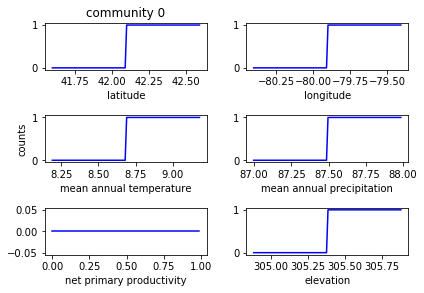

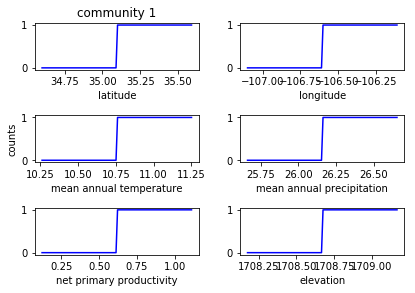

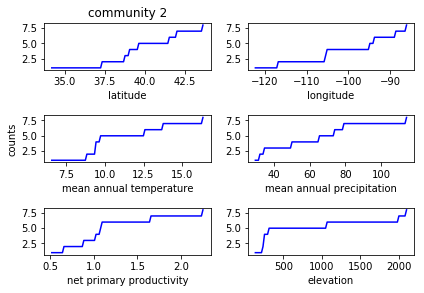

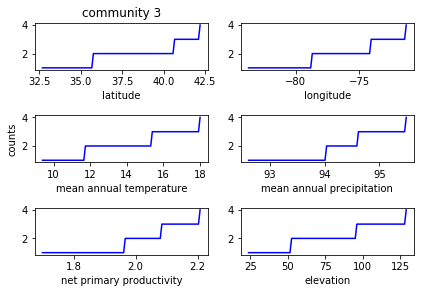

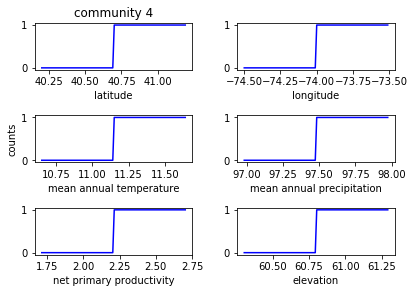

...

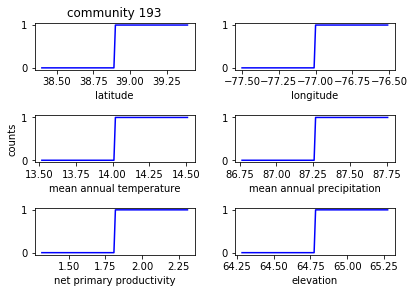

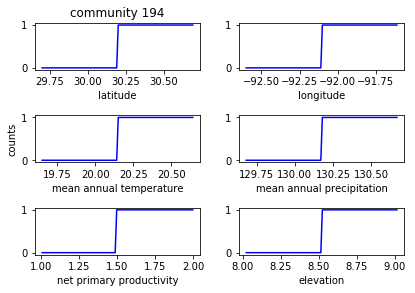

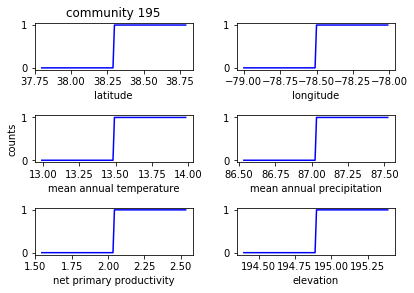

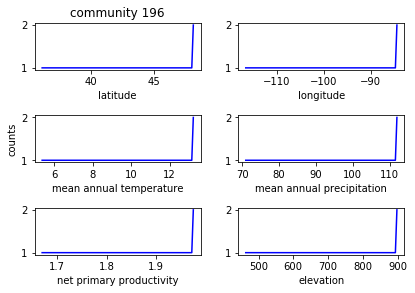

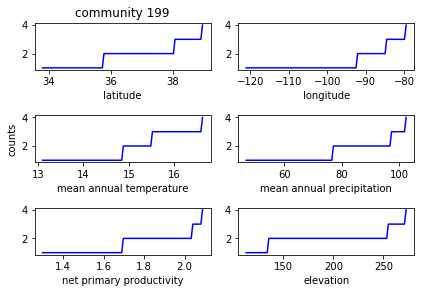

In [143]:
for t in range(num_com):
    plot_cum_hist_for_topic(t,dfnew,df,100)

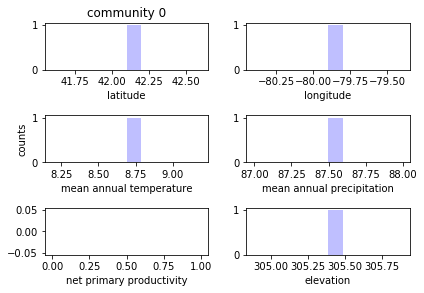

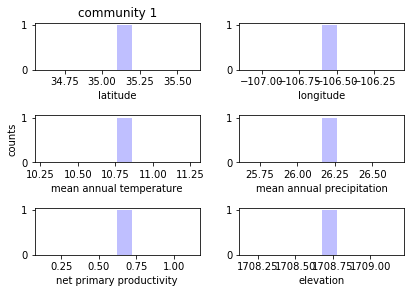

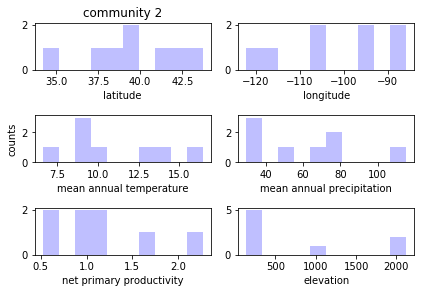

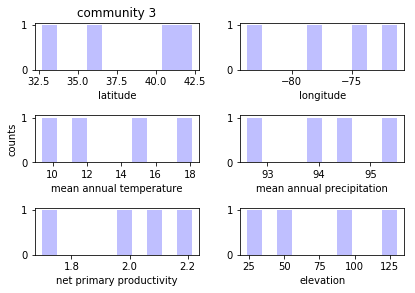

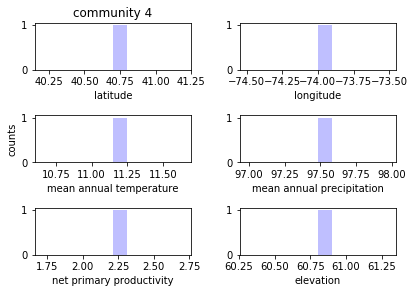

...

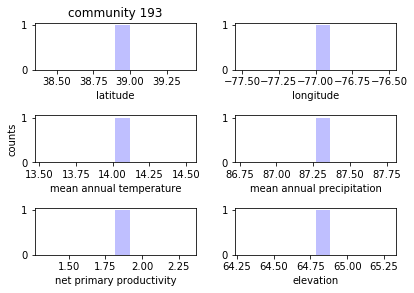

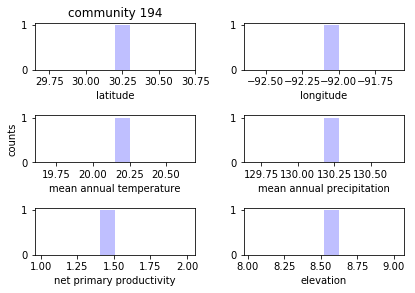

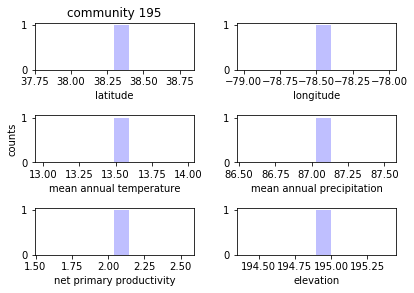

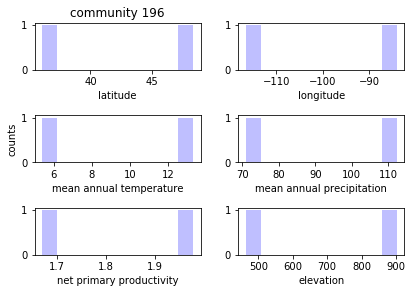

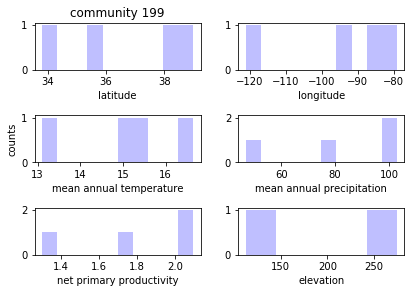

In [144]:
for t in range(num_com):
    plot_hist_for_topic2(t,dfnew,df)

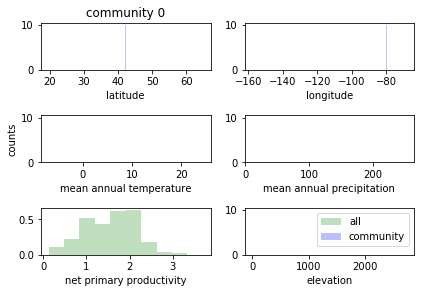

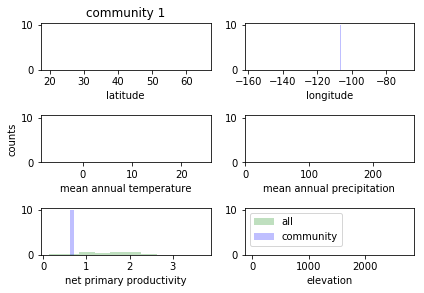

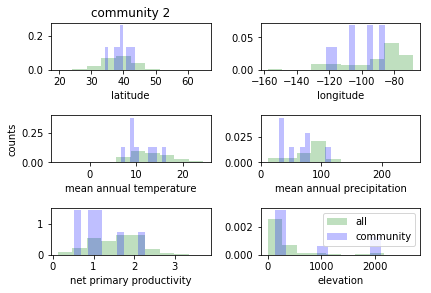

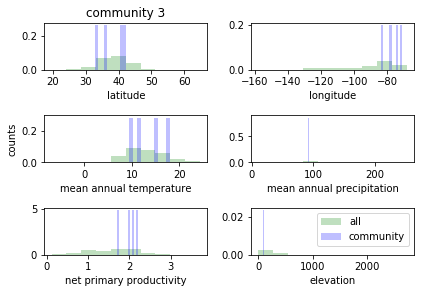

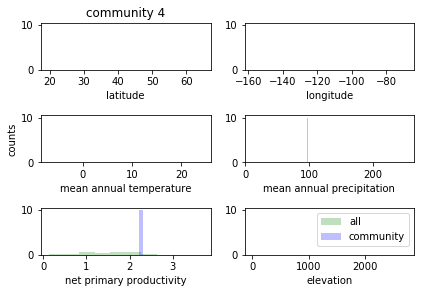

...

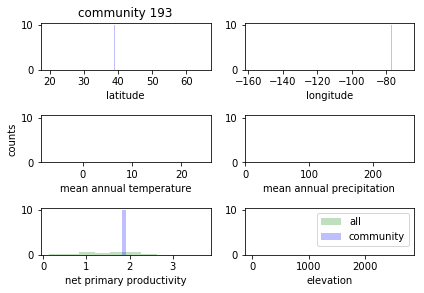

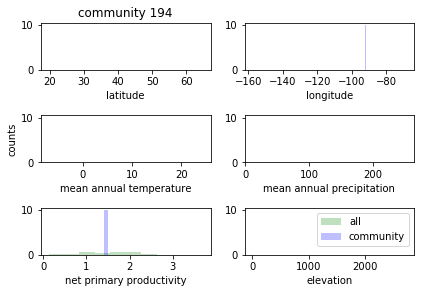

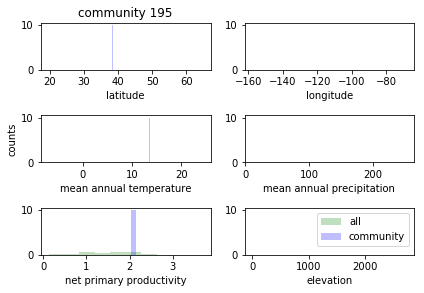

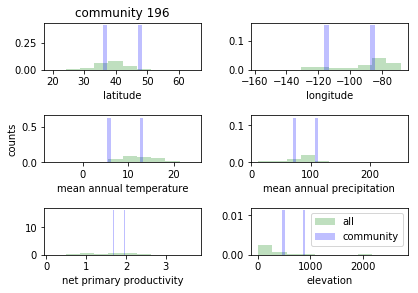

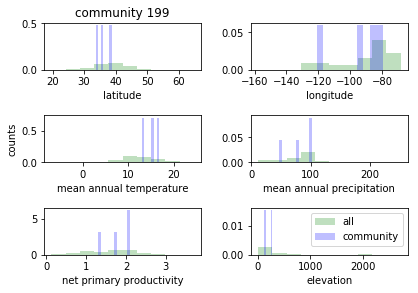

In [167]:
for t in range(num_com):
    plot_hist_for_topic(t,dfnew,df)

Now map the topics/communities geographically

In [146]:
def make_map_for_topic(topic,dfnew,df):
    #from mpl_toolkits.basemap import Basemap

    # llcrnrlat,llcrnrlon,urcrnrlat,urcrnrlon
    # are the lat/lon values of the lower left and upper right corners
    # of the map.
    # resolution = 'c' means use crude resolution coastlines.

    fig = plt.figure(figsize=(10,10))
    m = Basemap(projection='cyl',llcrnrlat=10,urcrnrlat=50,\
            llcrnrlon=-126,urcrnrlon=-55)

    m.drawcoastlines()
    m.drawstates()
    m.drawcountries()
    # add in locations where samples were taken
    lons = df['Longitude']
    lats = df['Latitude']
    x, y = m(lons,lats)
    m.scatter(x,y,3,marker='o',color='g',alpha=0.5)
    
    lons_c = dfnew.loc[topic,'longitude']
    lats_c = dfnew.loc[topic,'latitude']
    x_c, y_c = m(lons_c,lats_c)
    m.scatter(x_c,y_c,20,marker='x',color='r')
    
    plt.title('Community %d locations in red' % uniq_com[topic])
    plt.show()
    #savefname = 'fungi_500_samples_com' + str(topic) + '_map.png'
    #plt.savefig(savefname)

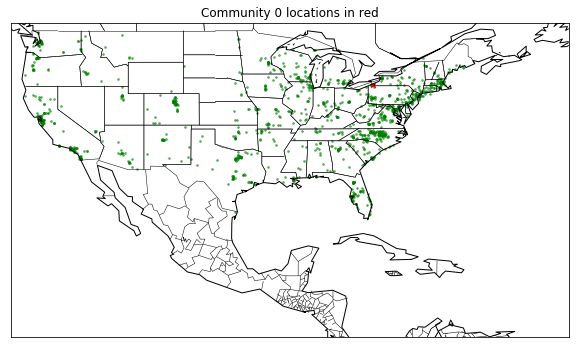

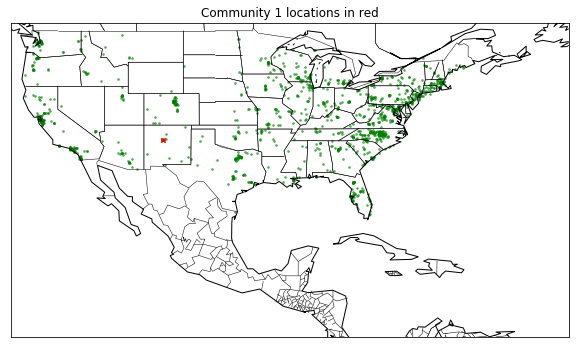

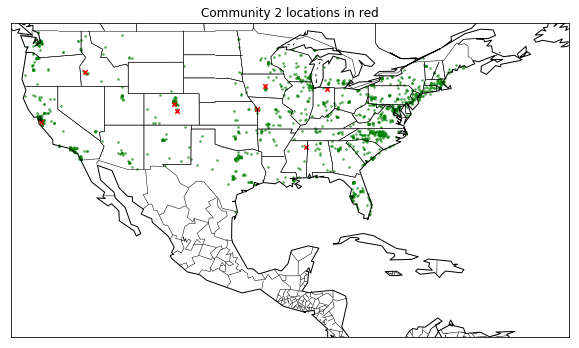

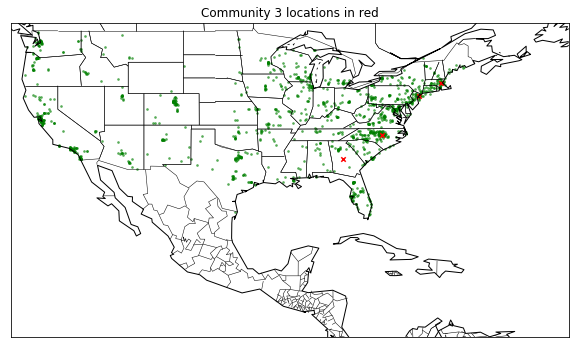

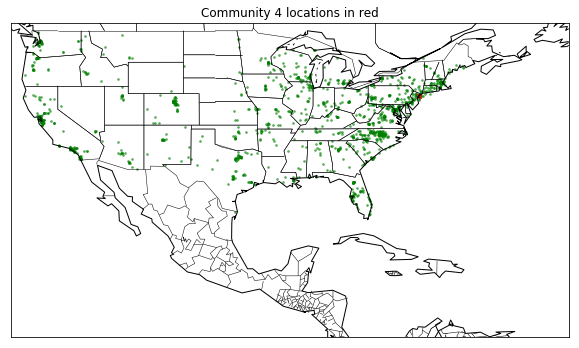

...

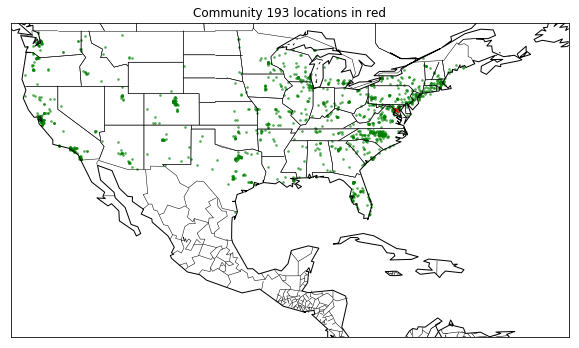

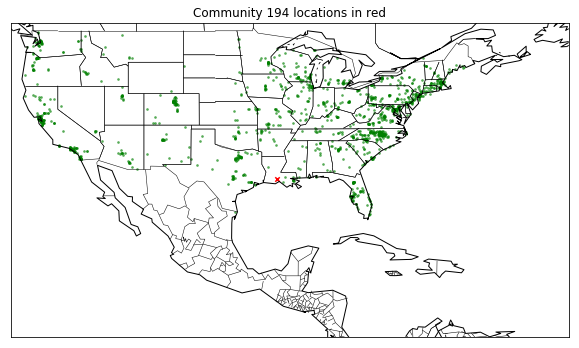

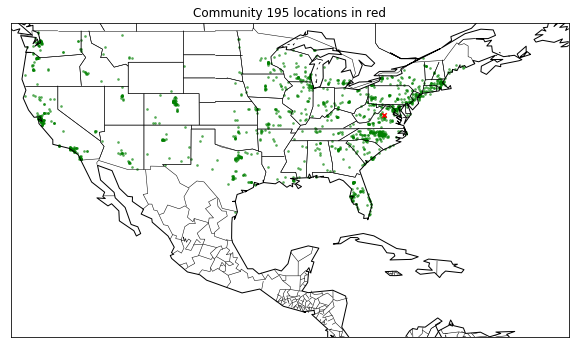

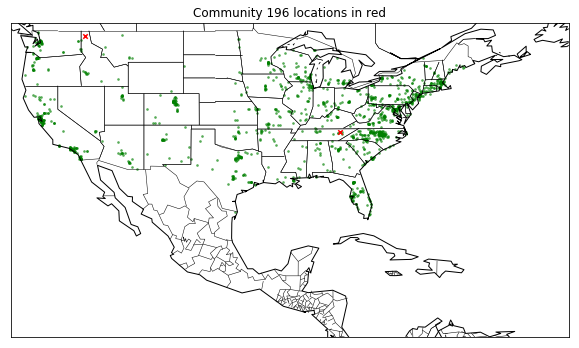

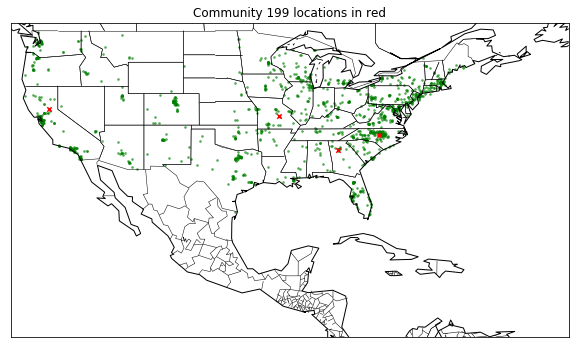

In [150]:
for t in range(num_com):
    make_map_for_topic(t,dfnew,df)

In [152]:
df['Latitude'].values

array([ 43.2,  35.1,  32.1, ...,  35.8,  40.7,  42.1])

In [153]:
samp_ids = array(list(xrange(len(samples))))
#print(samp_ids)

In [154]:
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D

# plot projection of articles onto 2 axes/topics defined by the model
def plot_3axes(x, y, z, tf_fit, samp_ids, labels):
    """Plot each article title according to the projection of its text 
    into the given x and y topic axes of model.
    
    :param x: the index of the x axis to plot
    :param y: the index of the y axis to plot
    :param tf_fit: the lda-transformed tf matrix
    :param samp_ids: a list of sample IDs (article titles)
    :param labels: a list of labels, indexed by sample IDs
    """
    x_data = defaultdict(list) 
    y_data = defaultdict(list) 
    z_data = defaultdict(list)
    arts = defaultdict(list)  
    for id in samp_ids:
        x_data[0].append(tf_fit[id][x]) 
        y_data[0].append(tf_fit[id][y])
        z_data[0].append(tf_fit[id][z])
        arts[0].append(labels[id])
    fig = pyplot.figure()
    ax = Axes3D(fig)    
    ax.scatter(list(x_data[0]), list(y_data[0]), list(z_data[0]),s=40)
    for art, x, y, z in zip(arts[0],x_data[0],y_data[0],z_data[0]):
        ax.text(x,y,z,  '%s' % (str(art)), size=10, zorder=1) 
    pyplot.show()

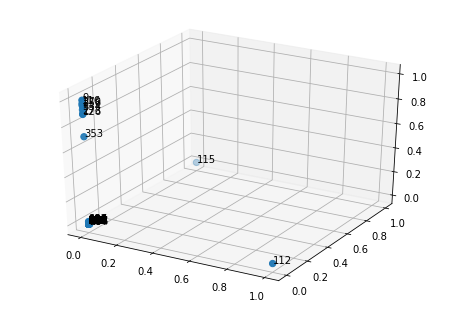

In [155]:
plot_3axes(x=0, y=1, z=2, tf_fit=tf_fit, samp_ids=samp_ids, labels=samp_ids)

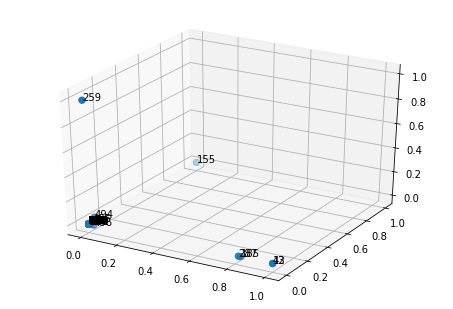

In [156]:
plot_3axes(x=3, y=4, z=5, tf_fit=tf_fit, samp_ids=samp_ids, labels=samp_ids)

In [43]:
import plotly.plotly as py
import plotly.graph_objs as go

import numpy as np

x, y, z = np.random.multivariate_normal(np.array([0,0,0]), np.eye(3), 200).transpose()
trace1 = go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='markers',
    marker=dict(
        size=12,
        line=dict(
            color='rgba(217, 217, 217, 0.14)',
            width=0.5
        ),
        opacity=0.8
    )
)
'''
x2, y2, z2 = np.random.multivariate_normal(np.array([0,0,0]), np.eye(3), 200).transpose()
trace2 = go.Scatter3d(
    x=x2,
    y=y2,
    z=z2,
    mode='markers',
    marker=dict(
        color='rgb(127, 127, 127)',
        size=12,
        symbol='circle',
        line=dict(
            color='rgb(204, 204, 204)',
            width=1
        ),
        opacity=0.9
    )
)
'''
#data = [trace1, trace2]
data = [trace1]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    )
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='simple-3d-scatter')